# **Image Caption with BLIP2**
###### **REFERENCE:** https://huggingface.co/blog/blip-2#image-captioning


#### 1. This will create the caption for one image of the ikea dataset



In [ ]:
# Install dependencies
!pip install git+https://github.com/huggingface/transformers.git
!pip install torch
!pip install accelerate

  Cloning https://github.com/huggingface/transformers.git to /tmp/pip-req-build-70ohfrvy
  Running command git clone --filter=blob:none --quiet https://github.com/huggingface/transformers.git /tmp/pip-req-build-70ohfrvy
  Resolved https://github.com/huggingface/transformers.git to commit 95b374952dc27d8511541d6f5a4e22c9ec11fb24
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 4.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 16.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 20.6 MB/s eta 0:00:00
  Created wheel for transformers: filename=transformers-4.34.0.dev0-py3-none-any.whl size=7640036 sha256=352c15f4d58d6215b2d606563daf6cc3bb0217a1d1d2d66cdd97b5d183262c30
  Stored in directory: /tmp/pip-ephem-wheel-cache-2zinifch/wheels/e7/9c/5b/e1a9c8007c343041e61cc484433d512ea9274272e3fcbe7c16


In [ ]:
# Load the data into a pandas dataframe:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!ls '/content/drive/MyDrive/MTECH_IS_Project/SEM02/dataset/ikeads_all_images/00089163.jpg'

/content/drive/MyDrive/MTECH_IS_Project/SEM02/dataset/ikeads_all_images/00089163.jpg


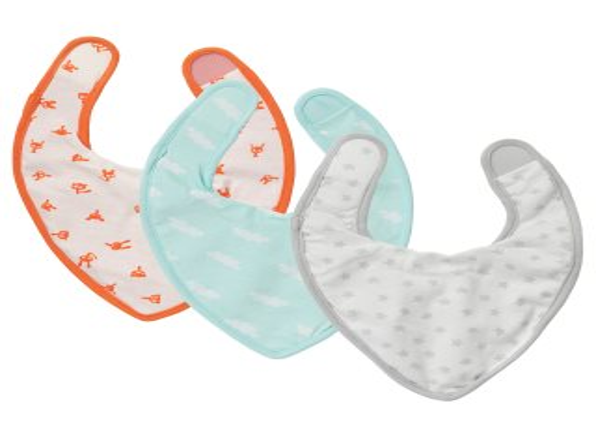

In [ ]:
# Input Image
from PIL import Image

jpg_file = '/content/drive/MyDrive/MTECH_IS_Project/SEM02/dataset/ikeads_all_images/00319526.jpg'
image = Image.open(jpg_file).convert('RGB')
display(image.resize((596, 437)))
# display(image.resize((512, 512)))

In [ ]:
# Load a BLIP-2 checkpoint that leverages the pre-trained OPT model by Meta AI, which has 2.7 billion parameters
# This ussually fails due to lack of resource - please make sure you have enough mem (or use collab pro v100)
from transformers import AutoProcessor, Blip2ForConditionalGeneration
import torch

processor = AutoProcessor.from_pretrained("Salesforce/blip2-opt-2.7b")
model = Blip2ForConditionalGeneration.from_pretrained("Salesforce/blip2-opt-2.7b", torch_dtype=torch.float16)


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

In [ ]:
# Set to use GPU to make text generation faster
device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)


Blip2ForConditionalGeneration(
  (vision_model): Blip2VisionModel(
    (embeddings): Blip2VisionEmbeddings(
      (patch_embedding): Conv2d(3, 1408, kernel_size=(14, 14), stride=(14, 14))
    )
    (encoder): Blip2Encoder(
      (layers): ModuleList(
        (0-38): 39 x Blip2EncoderLayer(
          (self_attn): Blip2Attention(
            (dropout): Dropout(p=0.0, inplace=False)
            (qkv): Linear(in_features=1408, out_features=4224, bias=True)
            (projection): Linear(in_features=1408, out_features=1408, bias=True)
          )
          (layer_norm1): LayerNorm((1408,), eps=1e-05, elementwise_affine=True)
          (mlp): Blip2MLP(
            (activation_fn): GELUActivation()
            (fc1): Linear(in_features=1408, out_features=6144, bias=True)
            (fc2): Linear(in_features=6144, out_features=1408, bias=True)
          )
          (layer_norm2): LayerNorm((1408,), eps=1e-05, elementwise_affine=True)
        )
      )
    )
    (post_layernorm): LayerNorm((

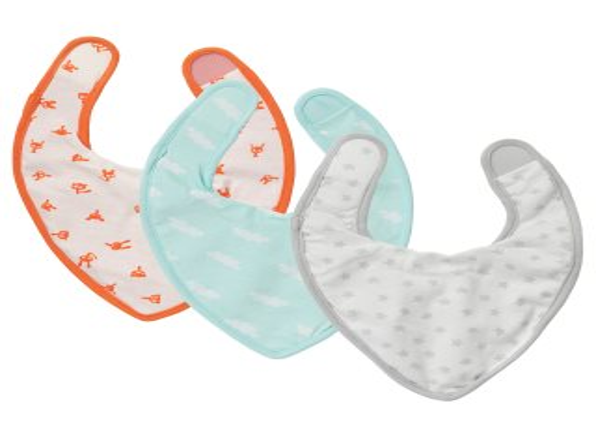

caption: three bibs with different designs on them


In [ ]:
# Image captioning
inputs = processor(image, return_tensors="pt").to(device, torch.float16)

generated_ids = model.generate(**inputs, max_new_tokens=20)
generated_text = processor.batch_decode(generated_ids, skip_special_tokens=True)[0].strip()
display(image.resize((596, 437)))
print('caption:',generated_text)


## **Bulk Image Captioning using BLIP2**

#### 2. This will create the caption for all the images of the ikea dataset directory

In [ ]:
from PIL import Image
import os
import torch
from torchvision import transforms
from torchvision.transforms.functional import InterpolationMode
import pandas as pd

images_loc = '/content/drive/MyDrive/MTECH_IS_Project/SEM02/dataset/ikeads_all_images'

def load_demo_images(image_folder, image_size, device):
    images = []
    for image_name in os.listdir(image_folder):
        if image_name.endswith(".jpg"):
          img_path = os.path.join(image_folder, image_name)
          raw_image = Image.open(img_path).convert('RGB')

          # display(raw_image.resize((596, 437)))

          w, h = raw_image.size
          display(raw_image.resize((w//5, h//5)))

          # transform = transforms.Compose([
          #     transforms.Resize((image_size, image_size), interpolation=InterpolationMode.BICUBIC),
          #     transforms.ToTensor(),
          #     transforms.Normalize((0.48145466, 0.4578275, 0.40821073), (0.26862954, 0.26130258, 0.27577711))
          # ])
          # image = transform(raw_image).unsqueeze(0).to(device)

          image = raw_image
          images.append(image)
    return images

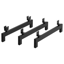

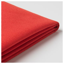

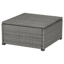

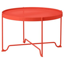

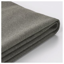

...

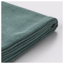

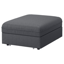

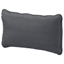

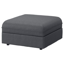

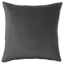

Streaming output truncated to the last 5000 lines.
Caption: a modern floor lamp with a metal base
Image Name: 09239827
Caption: a white nightstand with two drawers on top
Image Name: 80336758
Caption: a white floor lamp with a metal arm
Image Name: 90303106
Caption: a white floor lamp with a white shade
Image Name: 40429976
Caption: a white shelf with a glass top
Image Name: 30403566
Caption: a black chest of drawers with four drawers
Image Name: 19276621
Caption: a white dresser with drawers and a white cabinet
Image Name: 00214553
Caption: a white chest of drawers with four drawers
Image Name: 50430012
Caption: a glass shelf with a metal frame and a white background
Image Name: 80365543
Caption: the floor lamp is made of brass and has a white shade
Image Name: 90331374
Caption: the black floor lamp with a gold base and a black shade
Image Name: 10214557
Caption: a white chest of drawers with four drawers
Image Name: 20270802
Caption: a white and wood chest of drawers with three drawe

In [ ]:
def get_blip2_caption():
  img_path = images_loc
  image_size = 512
  images = load_demo_images(img_path, image_size=image_size, device=device)

  # model_url = 'https://storage.googleapis.com/sfr-vision-language-research/BLIP/models/model_base_capfilt_large.pth'
  # model = blip_decoder(pretrained=model_url, image_size=image_size, vit='base')
  # model.eval()
  # model = model.to(device)

  text_folder = img_path
  if not os.path.exists(text_folder):
      os.makedirs(text_folder)

  with torch.no_grad():
      cap_list = []
      cap_dict = {}
      cap_flag=False
      for i, image in enumerate(images):
        inputs = processor(image, return_tensors="pt").to(device, torch.float16)
        generated_ids = model.generate(**inputs, max_new_tokens=20)
        generated_text = processor.batch_decode(generated_ids, skip_special_tokens=True)[0].strip()
        image_name = os.listdir(img_path + '/')[i]
        image_name = os.path.splitext(image_name)[0]
        print("Image Name:", image_name)
        print("Caption:", generated_text)
        cap_flag=True

        if cap_flag:
          cap_dict["filename"] = image_name
          cap_dict["caption"] = generated_text
        if bool(cap_dict):
          cap_list.append(cap_dict)
          cap_dict = {}


        # list_img_name.append(image_name)
        # list_text_cap.append(generated_text)
        # with open(os.path.join(text_folder, f"{image_name}.txt"), "w") as f:
        #     f.write(generated_text[0])

  return cap_list

# Create a DataFrame and process the paths

blip2_cap = get_blip2_caption()
image_df = pd.DataFrame(blip2_cap)
# image_df = pd.DataFrame({'filename': image_name, 'caption': generated_text}, index=[i])

print("###### CAPTIONING COMPLETED ######")

In [ ]:
image_df.head(5)

,filename,caption
0,30284177,three black metal brackets on a white background
1,40336190,red fabric on a white background
2,90424599,a wicker outdoor ottoman with a grey cover
3,60406808,a red coffee table with metal legs
4,10336243,a close up of a gray fabric


In [ ]:
dataset_loc = '/content/drive/MyDrive/MTECH_IS_Project/SEM02/dataset/ikeads_all_images_blip2.csv'
image_df.to_csv(dataset_loc,  encoding='utf-8')

In [ ]:
# Load the data into a pandas dataframe:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# importing libary
import os
import pandas as pd
import numpy as np

In [ ]:
# load the SG Dataset
file = "/content/drive/MyDrive/MTECH_IS_Project/SEM02/dataset/ikeads_all_images_blip2.csv"
image_df = pd.read_csv(file, encoding = 'unicode_escape', engine ='python')
image_df = image_df.drop(columns=['Unnamed: 0'])
image_df.rename(columns={'filename': 'image'}, inplace=True)
image_df['filename'] = image_df['image'] + '.jpg'
image_df.head(3)

,image,caption,filename
0,30284177,three black metal brackets on a white background,30284177.jpg
1,40336190,red fabric on a white background,40336190.jpg
2,90424599,a wicker outdoor ottoman with a grey cover,90424599.jpg


In [ ]:
# load the SG Dataset
file = "/content/drive/MyDrive/MTECH_IS_Project/SEM02/dataset/furniture_tags.xlsx"
fur_tags_df = pd.read_excel(file)
index_col = "filename"
ikea_fur_tag_df = fur_tags_df.merge(
  image_df, on=index_col, how="left"
)
fur_tags_df.head(3)

,filename,product_id,product_name,room,class,caption,height,length,width,depth,notes,Unnamed: 11
0,00121766.jpg,121766.0,NaN,kitchen,bar stool,"a photo of white, wooden tall bar stool with b...",102.0,45.0,40.0,NaN,NaN,NaN
1,00217801.jpg,217801.0,NaN,kitchen,bar stool,"a photo of brown, wooden medium height bar sto...",91.0,45.0,40.0,NaN,NaN,NaN
2,00272656.jpg,272656.0,NaN,kitchen,bar stool,"a photo of modern industrial style white, wood...",90.0,50.0,48.0,NaN,NaN,NaN


In [ ]:

ikea_fur_tag_df = image_df.merge(
  fur_tags_df, on=index_col, how="left"
)

# ikea_fur_tag_df = fur_tags_df.merge(
#   image_df, on=index_col, how="left"
# )

# ikea_fur_tag_df.head(10)

# ikea_fur_tag_df['caption'] = ikea_fur_tag_df['caption_x'] + ',' + ikea_fur_tag_df['caption_y']
# # ikea_fur_tag_df = ikea_fur_tag_df.drop(columns=['Unnamed: 11','caption_y','caption_x'])
# # ikea_fur_tag_df.rename(columns={'filename': 'temp'}, inplace=True)
# # ikea_fur_tag_df.rename(columns={'image': 'filename'}, inplace=True)
# # ikea_fur_tag_df.rename(columns={'temp': 'image'}, inplace=True)

ikea_fur_tag_df.head(10)

,image,caption_x,filename,product_id,product_name,room,class,caption_y,height,length,width,depth,notes,Unnamed: 11
0,30284177,three black metal brackets on a white background,30284177.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,40336190,red fabric on a white background,40336190.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,90424599,a wicker outdoor ottoman with a grey cover,90424599.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,60406808,a red coffee table with metal legs,60406808.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,10336243,a close up of a gray fabric,10336243.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,79261155,an outdoor sectional sofa with black cushions,79261155.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,89252565,an outdoor sectional sofa with white cushions,89252565.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,50255536,a coffee cup sitting on top of a wooden tray,50255536.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,40339829,a yellow checkered sectional couch with a chaise,40339829.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,99054744,an outdoor sectional sofa with black cushions,99054744.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:


# Function to combine two columns separated by a comma, handling NaN values
def combine_columns(row):
    if pd.notna(row['caption_x']):
        return row['caption_x']
    elif pd.notna(row['caption_y']):
        return row['caption_y']
    else:
        return ''

# Apply the custom function to create the 'Merged' column
ikea_fur_tag_df['caption'] = ikea_fur_tag_df.apply(combine_columns, axis=1)
ikea_fur_tag_df = ikea_fur_tag_df.drop(columns=['Unnamed: 11','caption_y','caption_x'])

ikea_fur_tag_df.head(10)

,image,filename,product_id,product_name,room,class,height,length,width,depth,notes,caption
0,30284177,30284177.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,three black metal brackets on a white background
1,40336190,40336190.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,red fabric on a white background
2,90424599,90424599.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,a wicker outdoor ottoman with a grey cover
3,60406808,60406808.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,a red coffee table with metal legs
4,10336243,10336243.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,a close up of a gray fabric
5,79261155,79261155.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,an outdoor sectional sofa with black cushions
6,89252565,89252565.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,an outdoor sectional sofa with white cushions
7,50255536,50255536.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,a coffee cup sitting on top of a wooden tray
8,40339829,40339829.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,a yellow checkered sectional couch with a chaise
9,99054744,99054744.jpg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,an outdoor sectional sofa with black cushions


In [ ]:
dataset_loc = '/content/drive/MyDrive/MTECH_IS_Project/SEM02/dataset/ikeads_all_images_tags.csv'
ikea_fur_tag_df.to_csv(dataset_loc,  encoding='utf-8')